# Myeloid Cell Lineages - Healthy and T21

In [1]:
import scvelo as scv
import scanpy as sc
import cellrank as cr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import seaborn as sns
import scFates as scf

scv.settings.verbosity = 3
scv.settings.set_figure_params("scvelo")
cr.settings.verbosity = 2

# CellRank Trajectories

In [2]:
#open the myeloid, QC filtered, batch corrected, disease (Ts21) and healthy cells
adata = sc.read_h5ad('Single_Cell/Raw_Data/CELL_RANK_input_myeloid.h5ad')
adata.uns['sample_colors']= np.array(['#377EB8', '#E41A1C'], dtype=object)
del adata.obsm['X_diffmap']
adata

AnnData object with n_obs × n_vars = 30000 × 25411
    obs: 'dataset', 'subclust_v6', 'sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'louvain', 'umap_density_sample', 'pseudotime'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: '_attr2type', 'dataset_colors', 'diffmap_evals', 'genome', 'hvg', 'log1p', 'louvain', 'modality', 'neighbors', 'paga', 'pca', 'roots', 'sample_colors', 'subclust_v6_colors', 'subclust_v6_sizes', 'umap', 'umap_density_sample_params'
    obsm: 'X_fle', 'X_pca', 'X_pca_harmony', 'X_phi', 'X_umap', 'diffmap_knn_distances', 'diffmap_knn_indices', 'pca_harmony_knn_distances', 'pca_harmony_knn_indices'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'W_diffmap', 'W_pca_harmony', 'connectivities', 'distances'

In [83]:
#plot the PAGA graph
sc.set_figure_params(dpi=400, dpi_save=400, figsize=(10,10))
fig = sc.pl.paga(adata, node_size_scale=10, edge_width_scale=2, threshold=0.2, single_component=True, fontoutline=1.5,
          show=False, frameon=False)
plt.savefig('Single_Cell/MIRA/figures/PAGA.pdf')

/Users/jbezney/opt/anaconda3/envs/CELL_RANK/lib/python3.9/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


In [84]:
#show the difference in cell density between Ts21 and healthy cells
sc.tl.embedding_density(adata, groupby='sample')
sc.pl.embedding_density(adata, groupby='sample', basis='fle')

/Users/jbezney/opt/anaconda3/envs/CELL_RANK/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:444: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(cax, ax=ax, pad=0.01, fraction=0.08, aspect=30)


There is a change in density from Healthy cells to Ts21 cells

Without performing any differentiation analysis, there is a bias toward erythroid lineage in Ts21 samples

In [3]:
#need to hack the tool in order to use the cellrank kernel 
adata.layers["spliced"] = adata.X
adata.layers["unspliced"] = adata.X
scv.pp.moments(adata, n_pcs=30, n_neighbors=15)

computing moments based on connectivities
    finished (0:00:57) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [4]:
#automatically find the root HSC cell according to euclidean distance from density of all myeloid cells
center_myeloid = pd.DataFrame(adata.obsm['X_fle'])
center_myeloid.insert(0, 'Index', range(0, 0 + len(center_myeloid)))
center_myeloid['cell'] = adata.obs.index
center_myeloid = center_myeloid.set_index('cell')
center_myeloid['subclust_v6'] = adata.obs['subclust_v6'].astype(str)
mean_x = center_myeloid[0].median()
mean_y = center_myeloid[1].median()

array = center_myeloid[center_myeloid['subclust_v6']=='HSCs']
array['distance'] = np.sqrt((array[0] - mean_x)**2 + (array[1] - mean_y)**2)
max_dist_idx = array['distance'].idxmax()


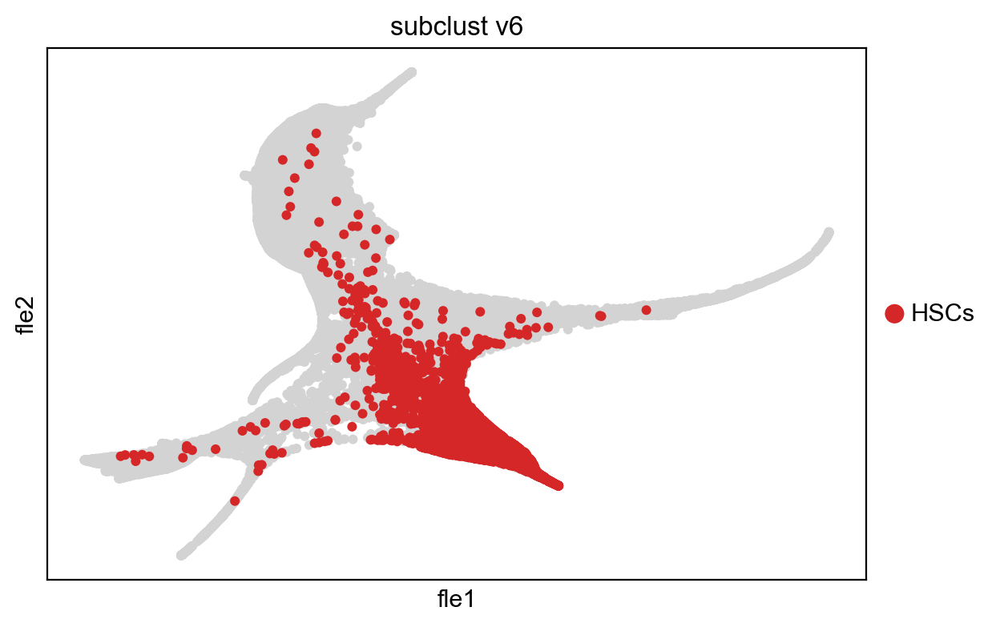

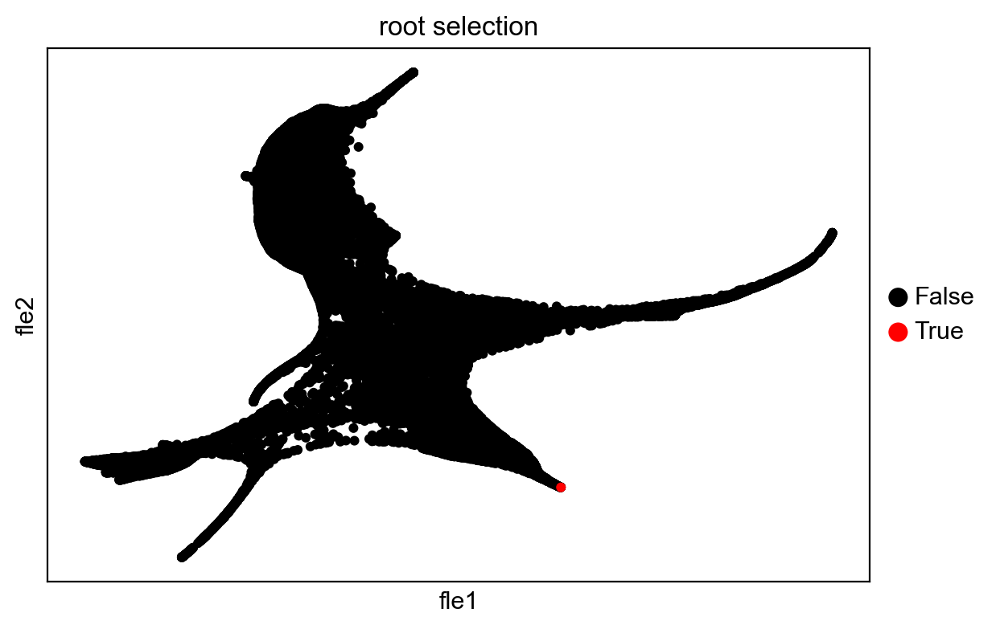

In [5]:
#plot the HSCs
sc.pl.scatter(adata, color='subclust_v6', groups='HSCs', basis='fle', size=75)

#plot the selected root cell
root_list = []
root_list.append(max_dist_idx)
adata.obs['root_selection'] = pd.Categorical((adata.obs.index.isin(root_list)))
adata.uns['root_selection_colors'] = ['black', 'red']
sc.pl.scatter(adata, color='root_selection', size=75, basis='fle')

In [6]:
#use the root to calculate diffusion map and pseudotime
root_index = array[array.index.isin(root_list)]
root_index = root_index.iloc[0].Index
adata.uns['iroot'] = root_index
sc.tl.diffmap(adata, n_comps=100)
sc.tl.dpt(adata, n_dcs=100)

In [7]:
from cellrank.tl.kernels import CytoTRACEKernel, PseudotimeKernel
psd = PseudotimeKernel(adata, time_key='dpt_pseudotime')

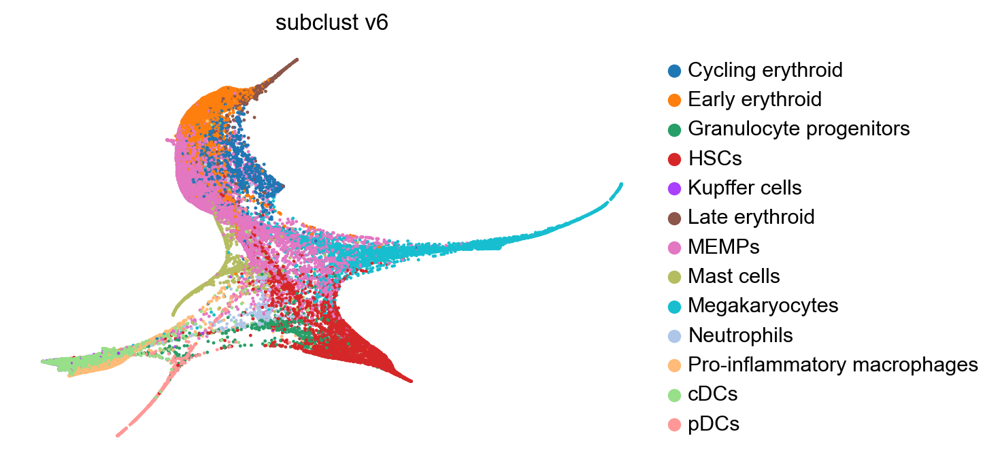

In [8]:
#plotting using scvelo functions
scv.pl.scatter(adata, basis="fle", c="subclust_v6", legend_loc="right")

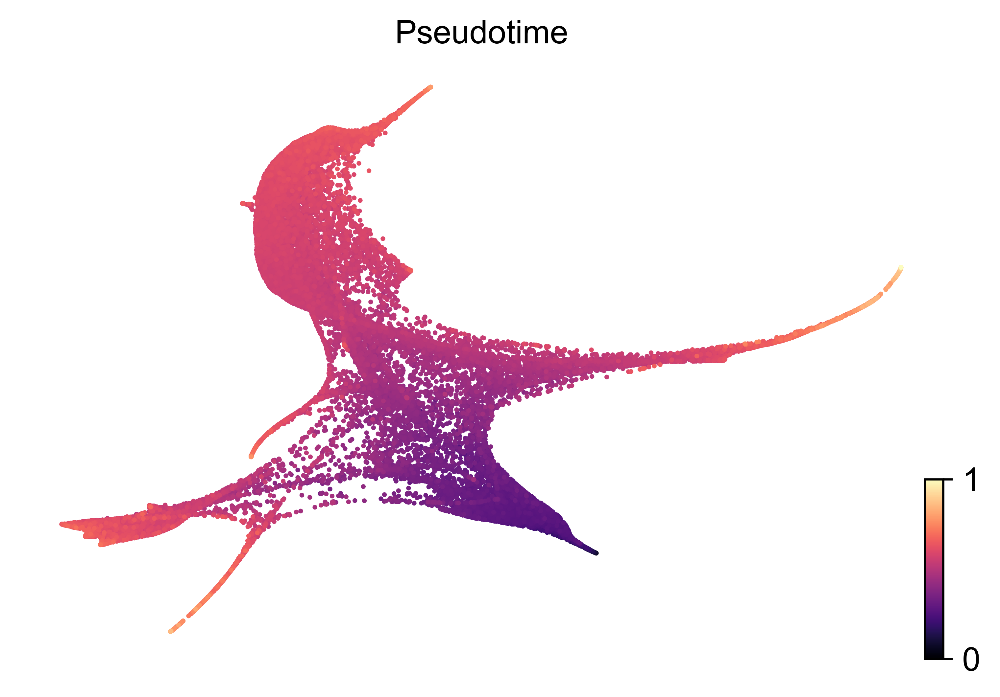

In [9]:
#pseudotime
scv.pl.scatter(adata, basis="fle", c="dpt_pseudotime", legend_loc="right",cmap='magma',
              title='Pseudotime', dpi=300)

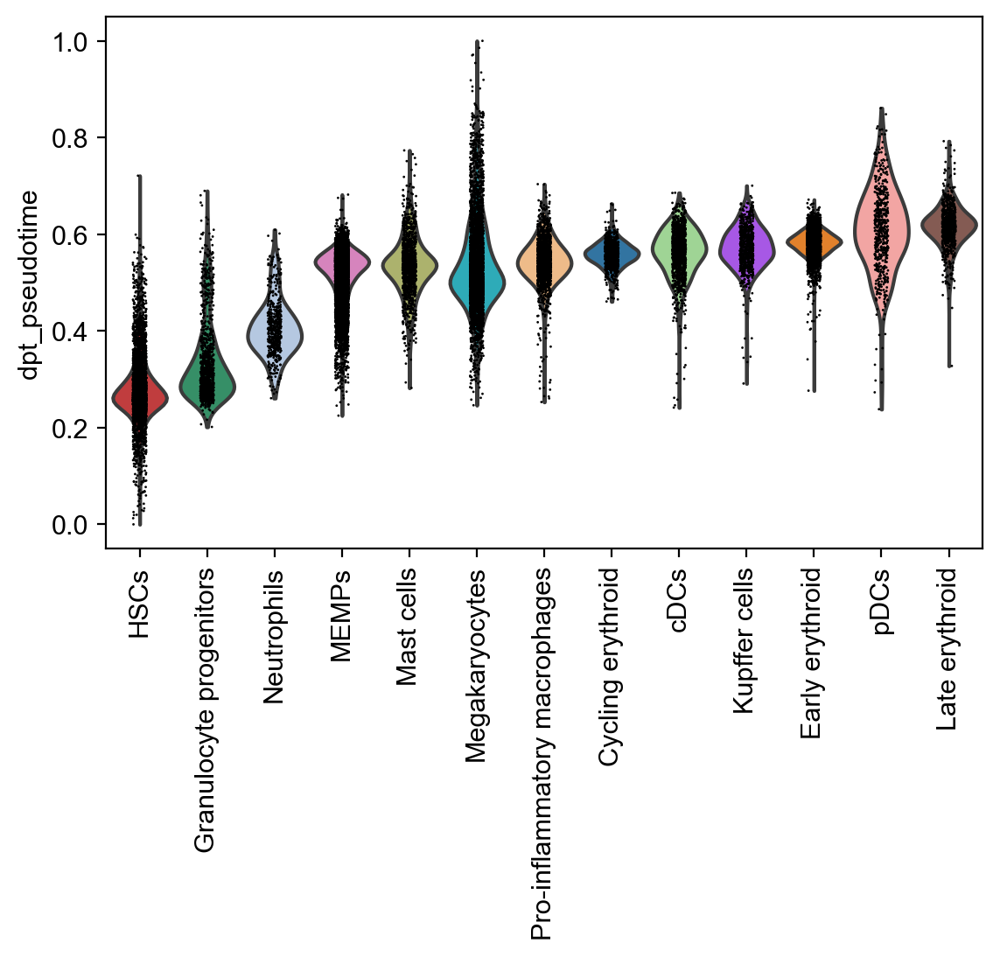

In [10]:
#find the order of cells according to pseudotime
time_order = pd.DataFrame(adata.obs)
time_order = time_order[['dpt_pseudotime','subclust_v6']]
time_order = time_order.groupby(["subclust_v6"]).mean()
time_order = time_order.sort_values(by='dpt_pseudotime', ascending=True)
time_order = list(time_order.index.values)
sc.pl.violin(adata, keys=["dpt_pseudotime"], groupby="subclust_v6", rotation=90, 
            order=time_order)

Other than Neutrophils, the HSCs and early progenitors (Granulocyte progenitors & MEMPs) are the earliest in pseudotime

This recapitulates known biological differentiation

In [11]:
#cell transition matrix
psd.compute_transition_matrix(threshold_scheme="soft", nu=0.5)
psd.compute_projection(basis="fle")

Computing transition matrix based on `dpt_pseudotime`


100%|██████████| 30000/30000 [00:07<00:00, 3860.61cell/s]


    Finish (0:00:15)
Projecting transition matrix onto `fle`
Adding `adata.obsm['T_fwd_fle']`
    Finish (0:00:10)


saving figure to file ./figures/scvelo_Trajectory_myeloid_differentiation.pdf


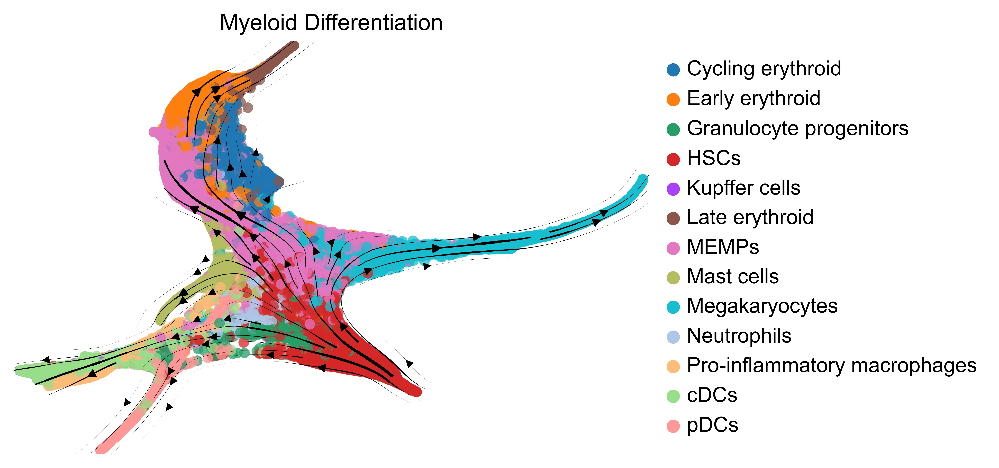

In [12]:
scv.pl.velocity_embedding_stream(
    adata, color="subclust_v6", vkey="T_fwd", basis="fle", legend_loc="right", dpi=400,size=125,alpha=0.75,
    figsize=(6,4), frameon=False,
    title='Myeloid Differentiation',save='Trajectory_myeloid_differentiation.pdf',
)

In [13]:
from cellrank.tl.estimators import GPCCA

g_fwd = GPCCA(psd)
print(g_fwd)

GPCCA[n=30000, kernel=<PseudotimeKernel[dnorm=False, scheme=soft, b=10.0, nu=0.5]>]


Computing Schur decomposition


Mat Object: 1 MPI processes
  type: seqdense
9.9999999999998912e-01 -7.1171302110452052e-05 -1.7349064869772869e-04 2.9558770409865112e-04 -1.1211741703951099e-03 -3.2776314842871149e-02 3.0424206780670388e-03 1.5213425565185163e-04 4.8279081730900775e-03 1.2820995567211326e-02 -5.9884423506888418e-03 -5.9849211283235268e-05 7.1112844139431400e-03 -2.6263906421887637e-03 -9.2356072704541869e-04 -2.7795527150302445e-03 4.0019810368780500e-03 -1.5968593882809310e-03 9.4940604494310309e-03 -8.8920934080826408e-03 -1.2869183345904560e-02 -6.5863223559572623e-03 -1.3778529464831027e-02 1.2510489788893939e-02 2.4792467366259543e-03 -2.8542730552010400e-04 
0.0000000000000000e+00 9.9992634227151278e-01 7.8784763188050663e-05 2.2756244658960023e-04 -1.7625009098778397e-03 8.5286787503606309e-03 1.0992805148803176e-02 2.1435584382760277e-03 2.3342022988149165e-03 -1.0060534339322044e-02 1.1458352544349938e-02 -2.6122993200698417e-02 -1.0267856354107686e-02 5.0964834585113224e-03 -1.156591732906

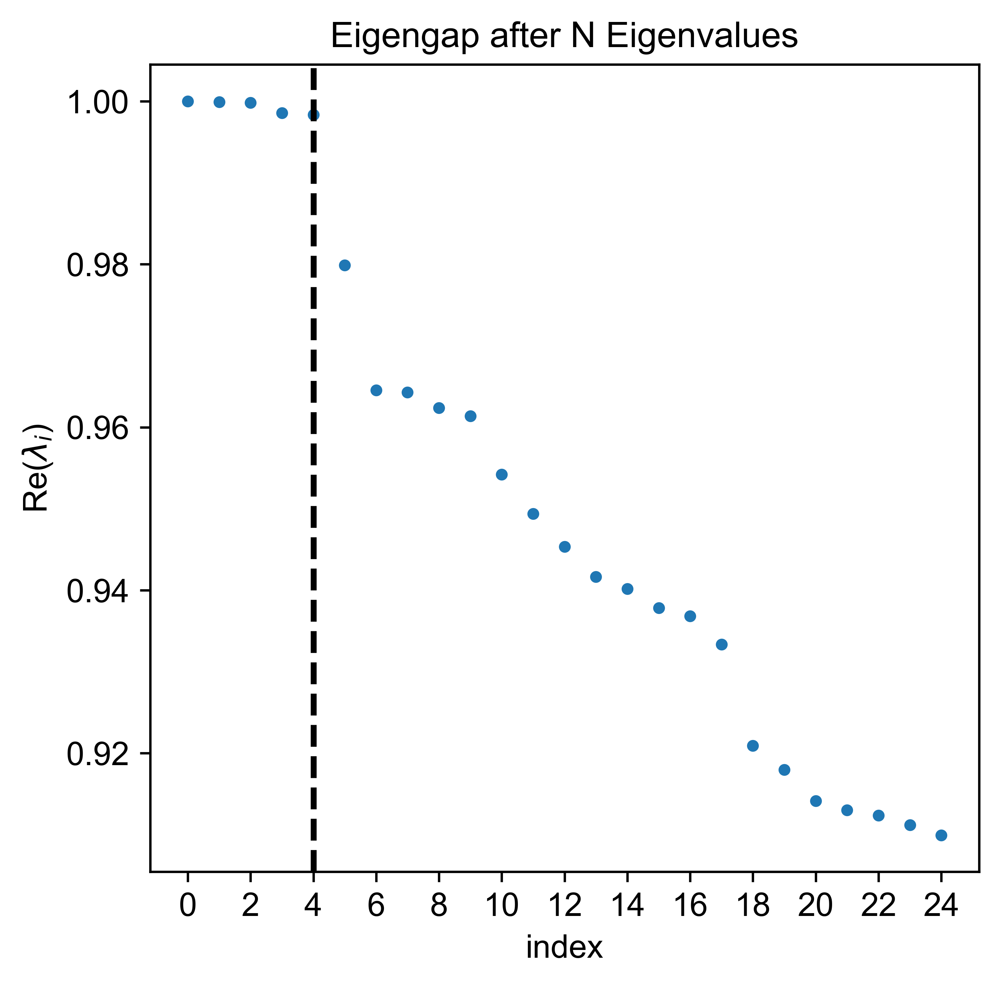

In [14]:
g_fwd.compute_schur(n_components=25, alpha=0.55)
g_fwd.plot_spectrum(real_only=True, title='Eigengap after N Eigenvalues', dpi=300,show_all_xticks=False)

Computing `5` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:03)


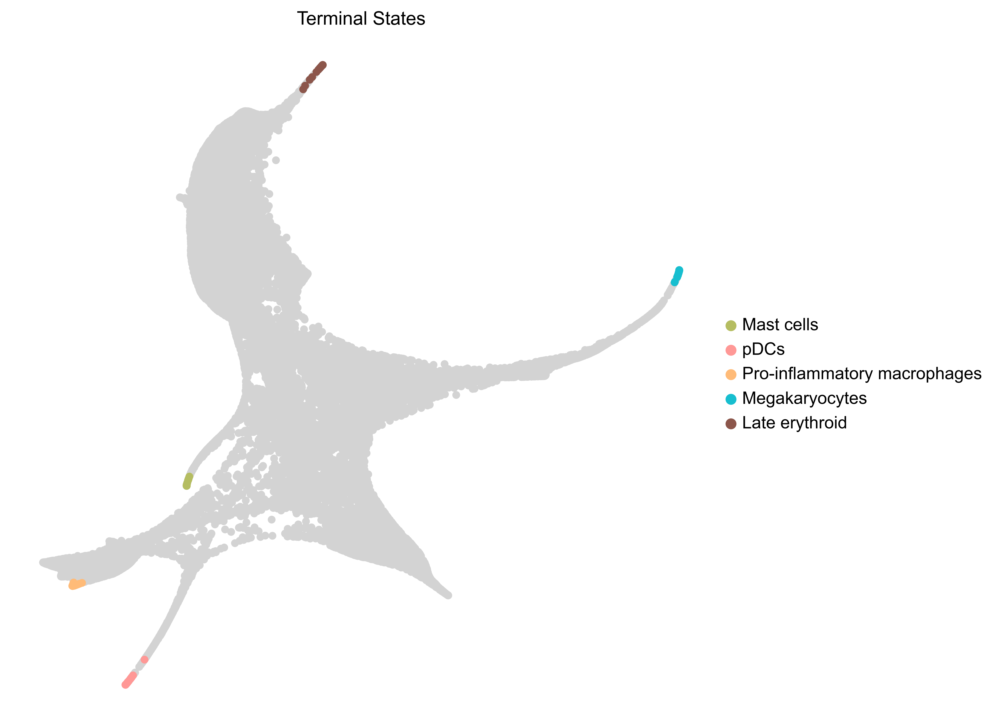

In [15]:
#according to the eigen-gap heuristic, data contains 5 terminal states
g_fwd.compute_macrostates(n_states=5, cluster_key="subclust_v6")
g_fwd.plot_macrostates(
    discrete=True, legend_loc="right", size=100, basis="fle", title='Terminal States',
    figsize=[8,8], dpi=400)

Adding `adata.obs['terminal_states']`
       `adata.obs['terminal_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`
Computing absorption probabilities


100%|██████████| 5/5 [00:00<00:00,  6.06/s]

Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:00)


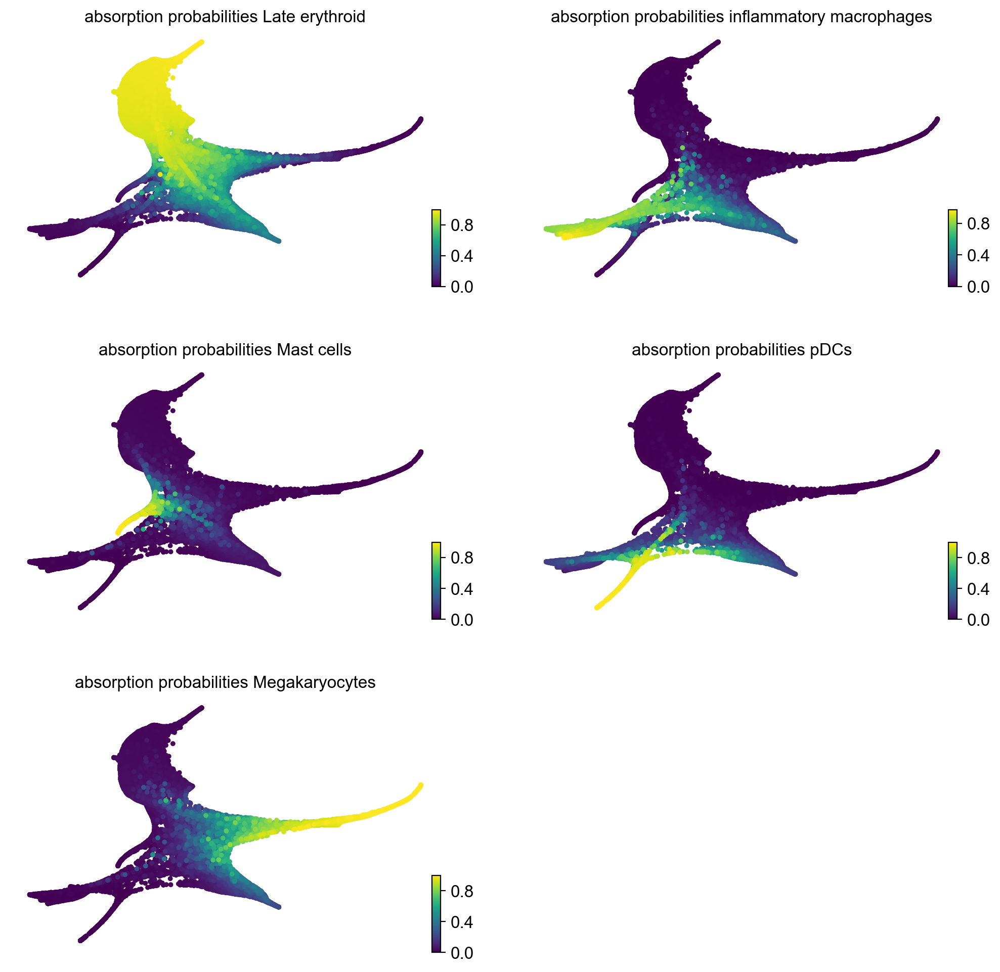

In [16]:
#absorption probability of each cell differentiating toward one of the terminal states
g_fwd.set_terminal_states_from_macrostates(names=["Late erythroid","Pro-inflammatory macrophages",'Mast cells',
                                                  'pDCs','Megakaryocytes'])
#rename lineages 
g_fwd.rename_terminal_states({'Late erythroid':'Late_erythroid',
                              'Pro-inflammatory macrophages':'inflammatory_macrophages', 
                              'Mast cells':'Mast_cells',
                              'pDCs':'pDCs',
                              'Megakaryocytes':'Megakaryocytes'
                             })
g_fwd.compute_absorption_probabilities()
g_fwd.plot_absorption_probabilities(same_plot=False, size=50, basis="fle", ncols=2)

Solving TSP for `5` states


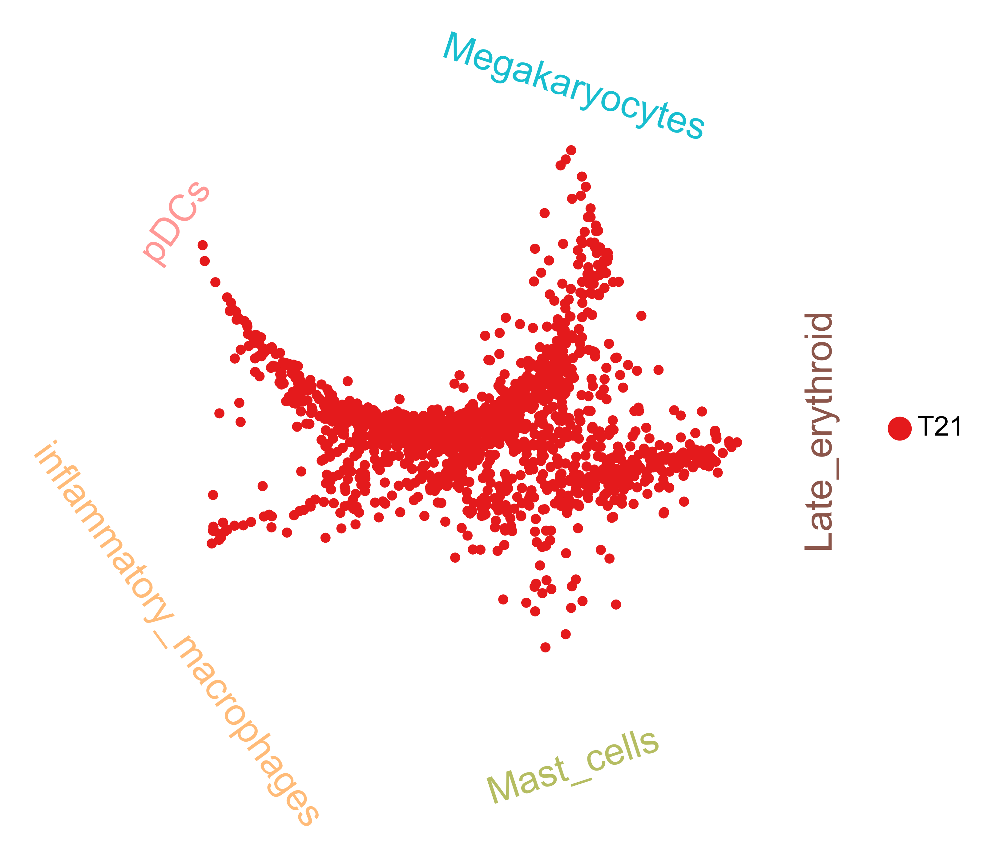

In [17]:
#disease HSC only
HSC_t21 = adata[(adata.obs['subclust_v6']=='HSCs')&(adata.obs['sample']=='T21')]
cr.pl.circular_projection(HSC_t21, keys=["sample"], legend_loc="right",
                         show_edges=False,title="", label_distance=1.1, legend_fontsize=8,figsize=(20,20),
                          dpi=400, size=35, save='Circular_T21_trajectories.pdf')

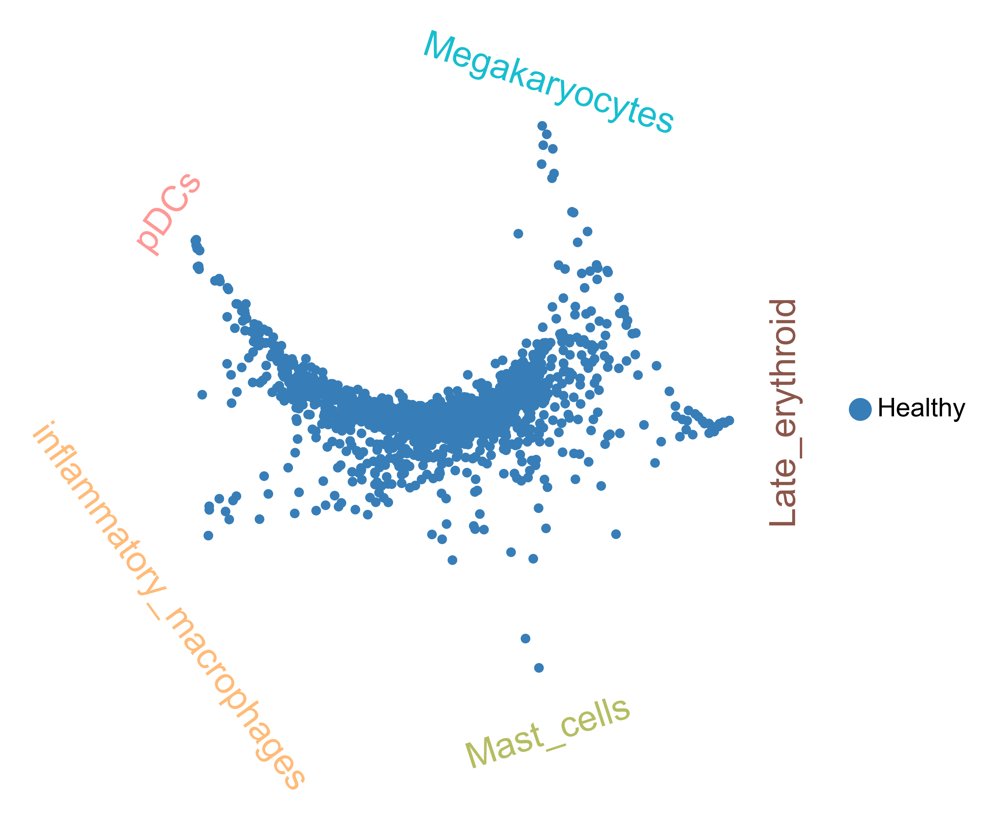

In [18]:
#healthy HSC only
HSC_healthy = adata[(adata.obs['subclust_v6']=='HSCs')&(adata.obs['sample']=='Healthy')]
cr.pl.circular_projection(HSC_healthy, keys=["sample"], legend_loc="right",lineages=['Late_erythroid','Megakaryocytes',
                        'pDCs','inflammatory_macrophages','Mast_cells'],lineage_order='default',
                         show_edges=False,title="", label_distance=1.1, legend_fontsize=8,figsize=(20,20),
                         dpi=400, size=35, save='Circular_Healthy_trajectories.pdf')


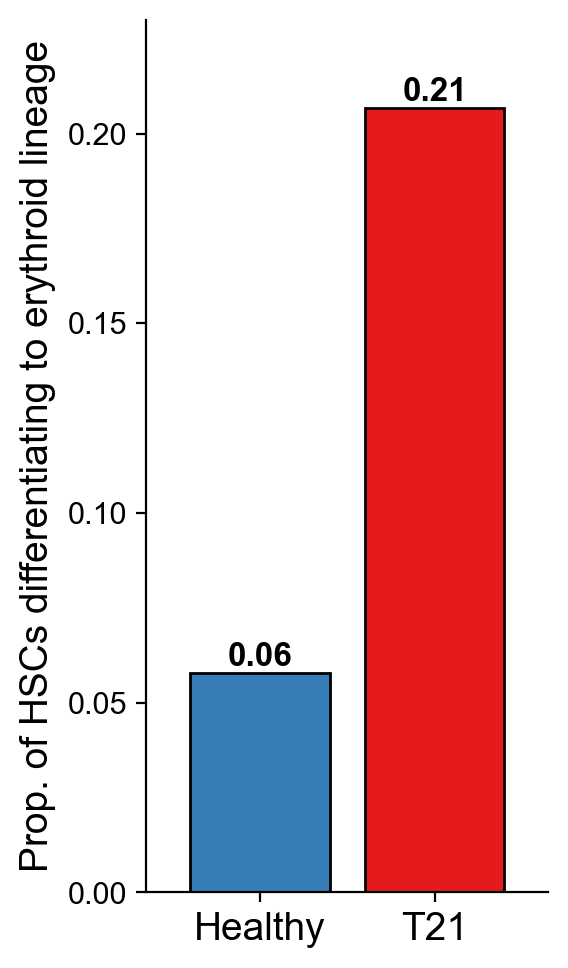

In [19]:
#create dataframe for t21, relative proportion
t21_df = pd.DataFrame(HSC_t21.obsm['to_terminal_states'], columns=['Late_erythroid','inflammatory_macrophages',
                                                                  'Mast_cells','pDCs','Megakaryocytes'])
t21_df['Max'] = t21_df.idxmax(axis=1)
t21_df['sample'] = 'T21'

#create dataframe for healthy, relative proportion 
healthy_df = pd.DataFrame(HSC_healthy.obsm['to_terminal_states'], columns=['Late_erythroid','inflammatory_macrophages',
                                                                  'Mast_cells','pDCs','Megakaryocytes'])
healthy_df['Max'] = healthy_df.idxmax(axis=1)
healthy_df['sample'] = 'Healthy'

#merge the dataframes and calculate the proportion moving toward erythroid lineage
merged_erythroid = pd.concat([healthy_df,t21_df])
merged_erythroid['Erythroid Differentiation Probability'] = merged_erythroid['Late_erythroid']

#Proportion of cells with probability greater than 0.5
merged_erythroid['Above_0.5'] = np.where(merged_erythroid["Erythroid Differentiation Probability"]>0.5, "Above 0.5", "Below 0.5")
proportion_df = pd.DataFrame(merged_erythroid.groupby('sample')['Above_0.5'].value_counts(), dtype=int)
proportion_df['Condition'] = proportion_df.index.get_level_values(0)
proportion_df['Threshold'] = proportion_df.index.get_level_values(1)

#we are declaring that a cell has to have above a 0.5 probability to be differentiating toward erythroid lineage
pivot = pd.pivot_table(proportion_df, index=['Condition'], columns=['Threshold'], values='Above_0.5')
pivot_freq = pivot.div(pivot.sum(axis=1), axis=0)

ax = pivot_freq.plot.bar(y='Above 0.5', figsize=(3,5), grid=False, width=0.8,
                        edgecolor='black', color=["#377EB8","#E41A1C"], legend=False
                         )

ax.bar_label(ax.containers[0], fmt='%.2f', fontsize=12, fontweight='bold')

ax.set_ylim(0,0.23)
ax.set_xticklabels(['Healthy','T21'], rotation=0, fontsize=14)
ax.set_xlabel('')
ax.set_ylabel('Prop. of HSCs differentiating to erythroid lineage', fontsize=14)

sns.despine()
plt.tight_layout()
plt.savefig('figures/Proportion_erythroid_differentiation.pdf')


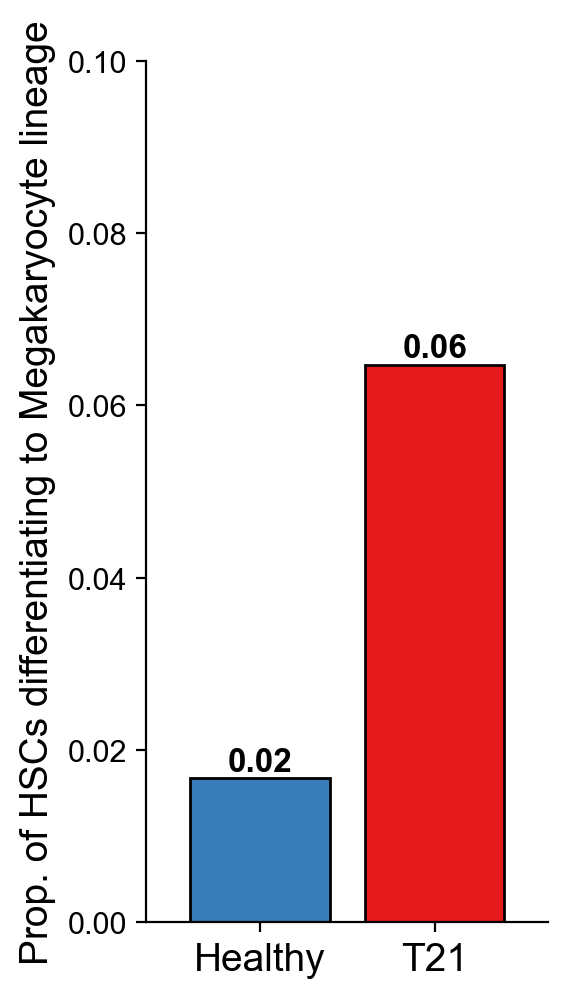

In [20]:
#merge the dataframes and calculate the proportion moving toward megakaryocyte lineage
merged_mega = pd.concat([healthy_df,t21_df])
merged_mega['Megakaryocyte Differentiation Probability'] = merged_mega['Megakaryocytes']

#decreased the threshold in order to capture more cells to see if there is a difference
#Proportion of cells with probability greater than 0.4
merged_mega['Above_0.4'] = np.where(merged_mega["Megakaryocyte Differentiation Probability"]>0.4, "Above 0.4", "Below 0.4")
proportion_df = pd.DataFrame(merged_mega.groupby('sample')['Above_0.4'].value_counts(), dtype=int)
proportion_df['Condition'] = proportion_df.index.get_level_values(0)
proportion_df['Threshold'] = proportion_df.index.get_level_values(1)

#we are declaring that a cell has to have above a 0.4 probability to be differentiating toward Megakaryocyte lineage
pivot = pd.pivot_table(proportion_df, index=['Condition'], columns=['Threshold'], values='Above_0.4')
pivot_freq = pivot.div(pivot.sum(axis=1), axis=0)

ax = pivot_freq.plot.bar(y='Above 0.4', figsize=(3,5), grid=False, width=0.8,
                        edgecolor='black', color=["#377EB8","#E41A1C"], legend=False
                         )

ax.bar_label(ax.containers[0], fmt='%.2f', fontsize=12, fontweight='bold')

ax.set_ylim(0,0.1)
ax.set_xticklabels(['Healthy','T21'], rotation=0, fontsize=14)
ax.set_xlabel('')
ax.set_ylabel('Prop. of HSCs differentiating to Megakaryocyte lineage', fontsize=14)

sns.despine()
plt.tight_layout()
plt.savefig('figures/Proportion_Megakaryocyte_differentiation.pdf')

# Individual Gene Markers - Lineage Drivers

saving figure to file ./figures/scvelo_Myleoid_Lineages_SAMHD1.pdf


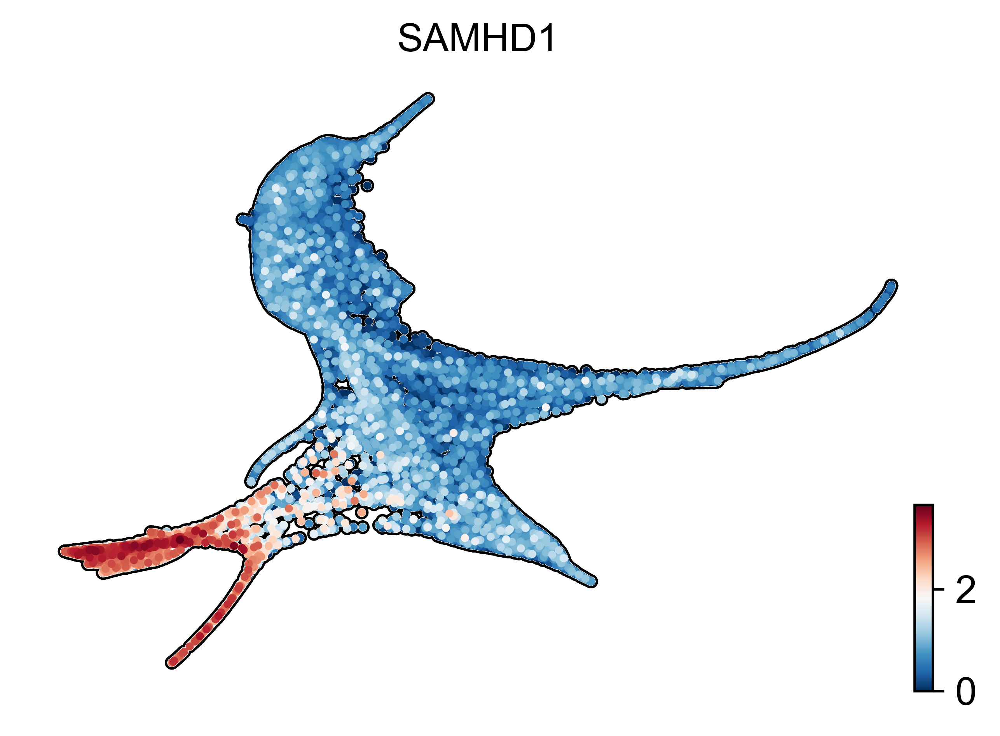

In [57]:
#Publication gene expression plots
scv.set_figure_params(dpi_save=300)
scv.pl.scatter(adata, color='SAMHD1', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_SAMHD1.pdf')


saving figure to file ./figures/scvelo_Myleoid_Lineages_LMO4.pdf


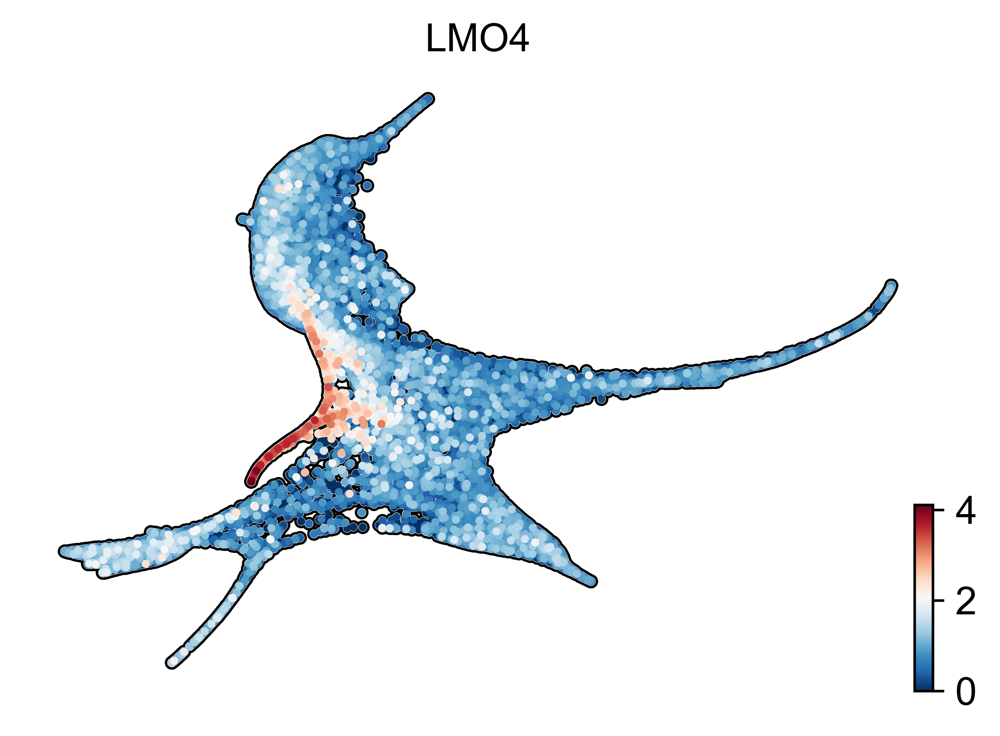

In [21]:
scv.pl.scatter(adata, color='LMO4', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_LMO4.pdf')

saving figure to file ./figures/scvelo_Myleoid_Lineages_TFRC.pdf


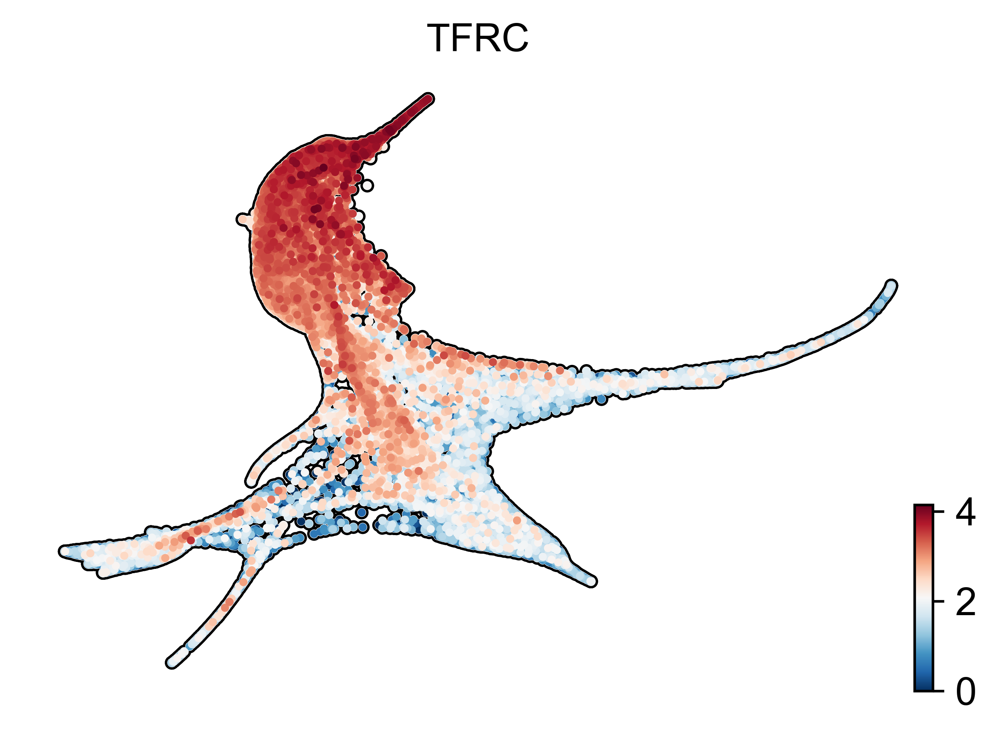

In [22]:
scv.pl.scatter(adata, color='TFRC', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_TFRC.pdf')

saving figure to file ./figures/scvelo_Myleoid_Lineages_PROM1.pdf


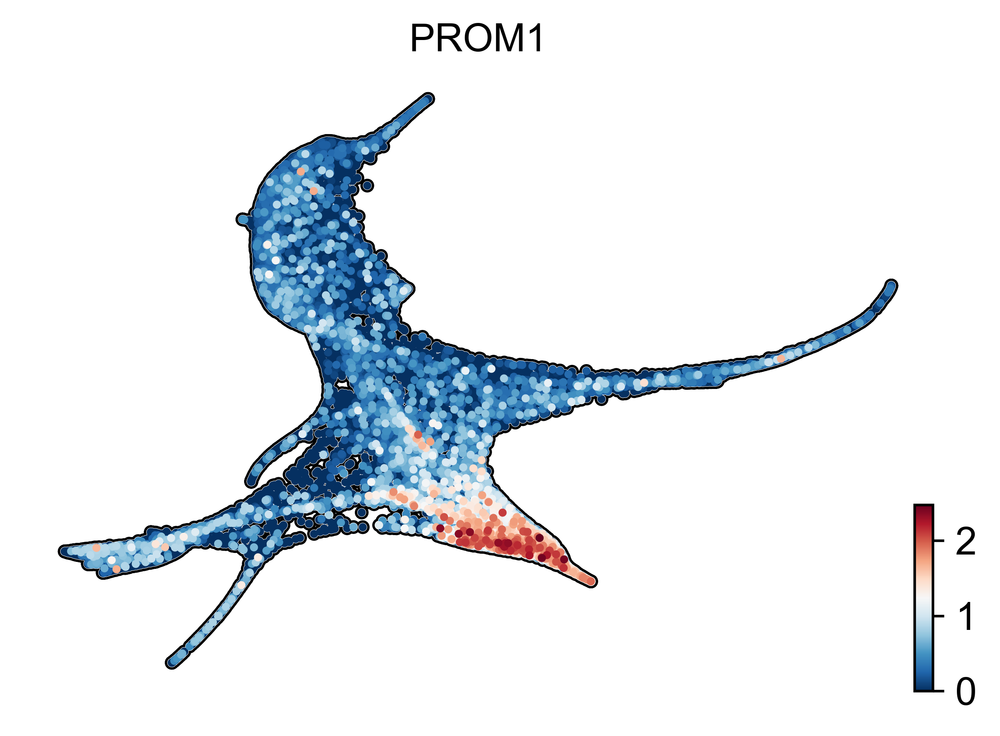

In [23]:
scv.pl.scatter(adata, color='PROM1', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_PROM1.pdf')

saving figure to file ./figures/scvelo_Myleoid_Lineages_ITGA2B.pdf


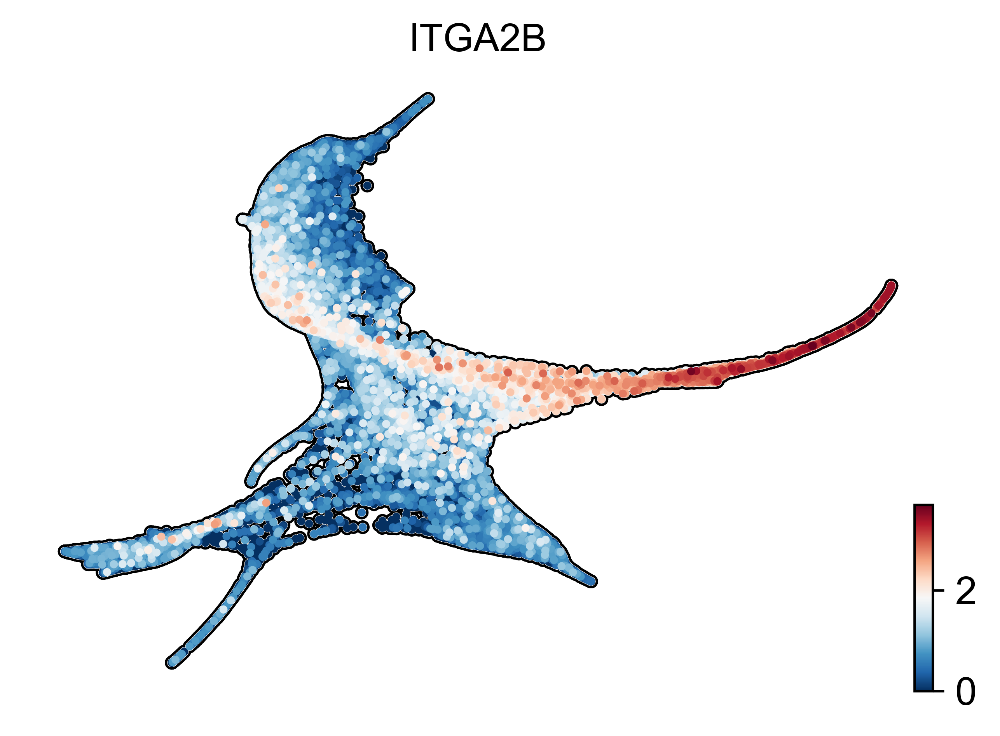

In [24]:
scv.pl.scatter(adata, color='ITGA2B', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_ITGA2B.pdf')

saving figure to file ./figures/scvelo_Myleoid_Lineages_IRF8.pdf


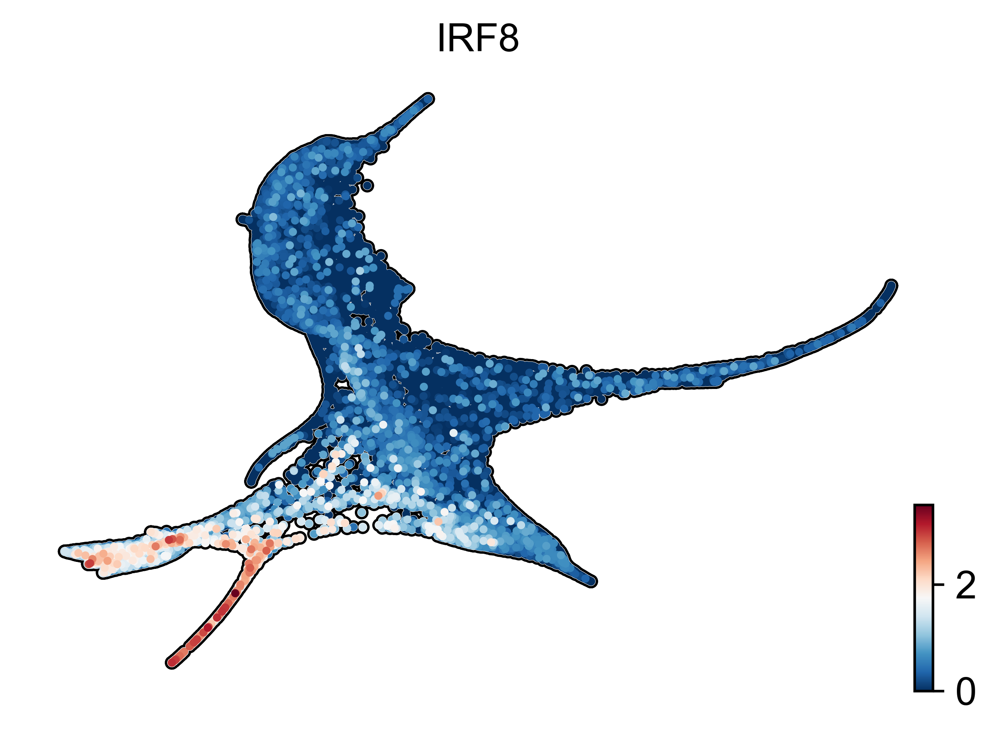

In [25]:
scv.pl.scatter(adata, color='IRF8', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_IRF8.pdf')

saving figure to file ./figures/scvelo_Myleoid_Lineages_ANK1.pdf


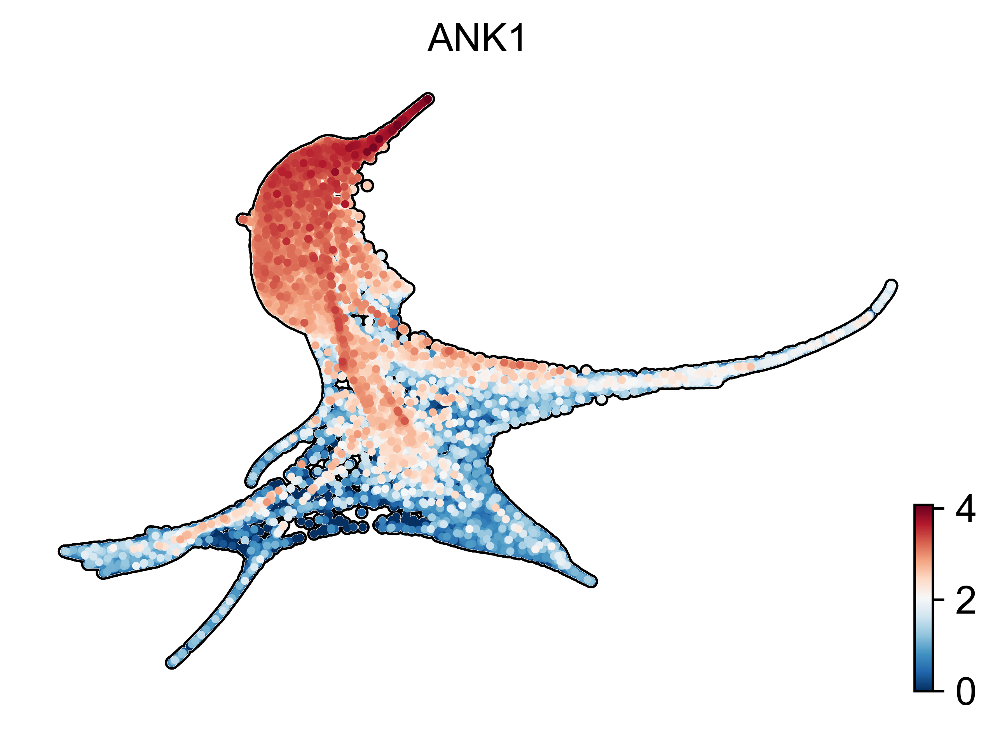

: 

In [26]:
scv.pl.scatter(adata, color='ANK1', basis='fle', size=25, figsize=(5,3.5),smooth=2,
              add_outline=True, dpi=300, save='Myleoid_Lineages_ANK1.pdf')

Genes driving lineage differentiation

In [69]:
erythroid_drivers = g_fwd.compute_lineage_drivers(lineages="Late_erythroid", return_drivers=True)
erythroid_drivers.sort_values(by="Late_erythroid_corr", ascending=False)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:04)


,Late_erythroid_corr,Late_erythroid_pval,Late_erythroid_qval,Late_erythroid_ci_low,Late_erythroid_ci_high
featurekey,,,,,
ANK1,0.635830,0.0,0.0,0.629040,0.642523
TFR2,0.583726,0.0,0.0,0.576216,0.591137
WNT5B,0.571468,0.0,0.0,0.563798,0.579039
PVT1,0.546877,0.0,0.0,0.538896,0.554760
TFRC,0.540578,0.0,0.0,0.532519,0.548538
...,...,...,...,...,...
MYO1F,-0.406750,0.0,0.0,-0.416151,-0.397263
ABR,-0.411083,0.0,0.0,-0.420443,-0.401635
AC020916.1,-0.420567,0.0,0.0,-0.429837,-0.411208


In [55]:
#save those into a file 
pfiltered = erythroid_drivers.copy()
pfiltered = pfiltered[pfiltered['Late_erythroid_corr']>0]
pfiltered.to_csv('Single_Cell/Raw_Data/CELLRANK_outs/DRIVERS_late_erythroid.csv')

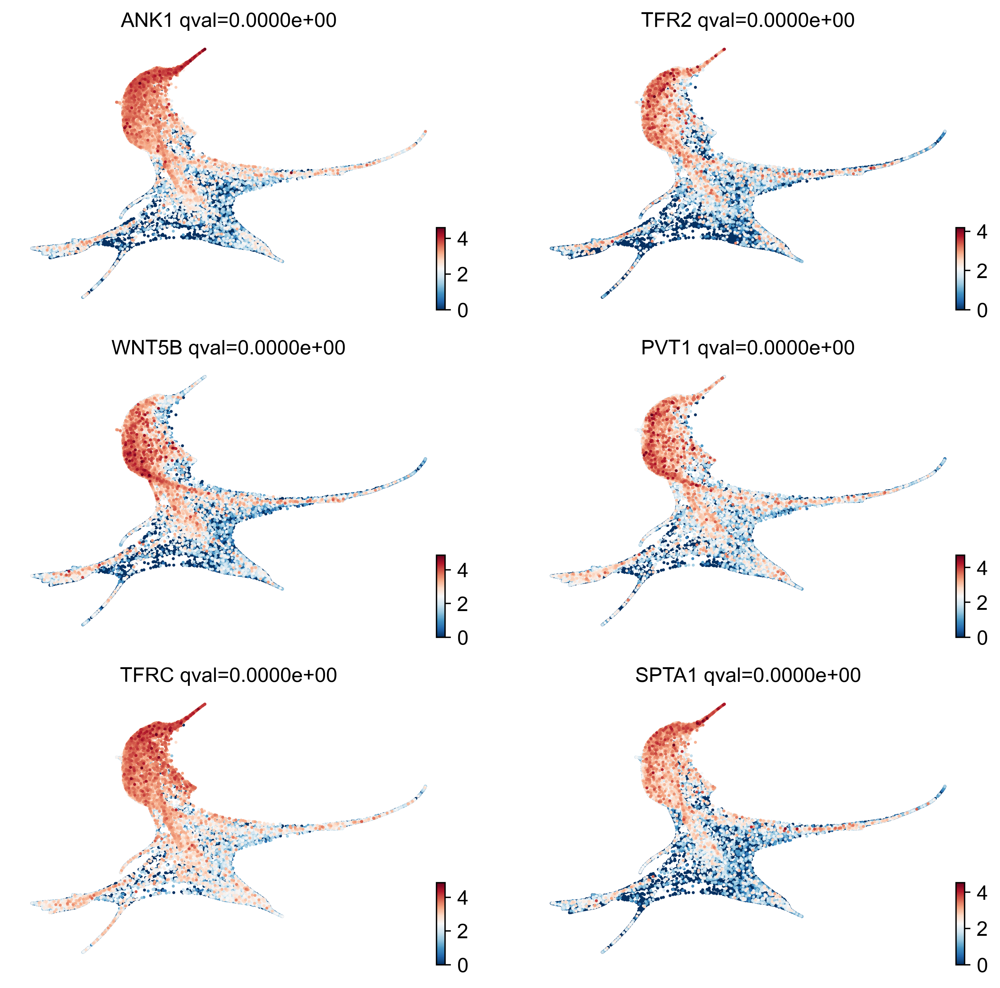

In [56]:
g_fwd.plot_lineage_drivers("Late_erythroid", n_genes=6, basis='fle', ncols=2, figsize=(10,10), dpi=200)

In [57]:
inflammatory_macrophages_drivers = g_fwd.compute_lineage_drivers(lineages="inflammatory_macrophages", 
                                                                     return_drivers=True)
inflammatory_macrophages_drivers.sort_values(by="inflammatory_macrophages_corr", ascending=False)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:04)


,inflammatory_macrophages_corr,inflammatory_macrophages_pval,inflammatory_macrophages_qval,inflammatory_macrophages_ci_low,inflammatory_macrophages_ci_high
featurekey,,,,,
MYO1F,0.558655,0.0,0.0,0.550821,0.566390
SAMHD1,0.553932,0.0,0.0,0.546039,0.561727
RBM47,0.522574,0.0,0.0,0.514299,0.530751
PTPRE,0.517097,0.0,0.0,0.508758,0.525339
ANXA1,0.506219,0.0,0.0,0.497754,0.514587
...,...,...,...,...,...
MYH10,-0.389408,0.0,0.0,-0.398966,-0.379766
TFR2,-0.392407,0.0,0.0,-0.401938,-0.382791
ZMYND8,-0.392533,0.0,0.0,-0.402063,-0.382918


In [58]:
#save those into a file 
pfiltered = inflammatory_macrophages_drivers.copy()
pfiltered = pfiltered[pfiltered['inflammatory_macrophages_corr']>0]
pfiltered.to_csv('Single_Cell/Raw_Data/CELLRANK_outs/DRIVERS_inflammatory_macrophages.csv')

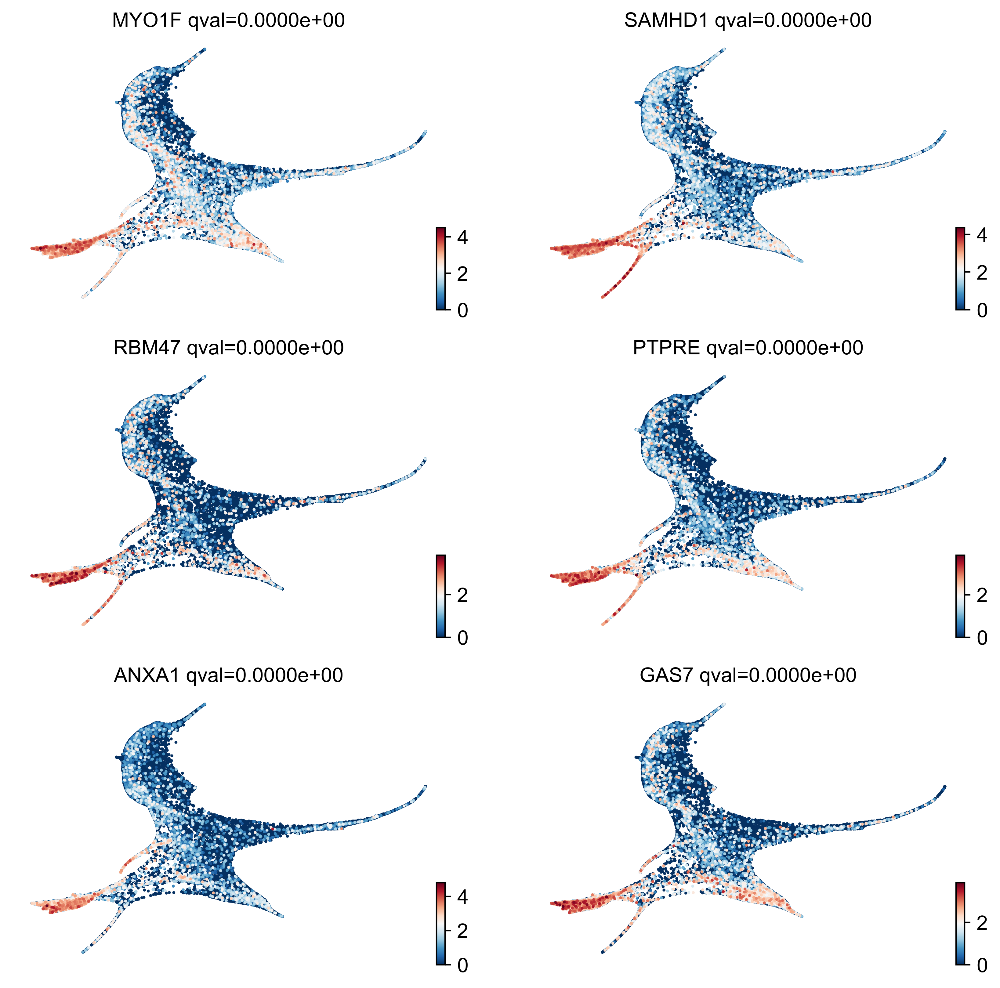

In [59]:
g_fwd.plot_lineage_drivers("inflammatory_macrophages", n_genes=6, basis='fle', ncols=2, figsize=(10,10), dpi=200)

In [60]:
Mast_drivers = g_fwd.compute_lineage_drivers(lineages="Mast_cells", return_drivers=True)
Mast_drivers.sort_values(by="Mast_cells_corr", ascending=False)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:04)


,Mast_cells_corr,Mast_cells_pval,Mast_cells_qval,Mast_cells_ci_low,Mast_cells_ci_high
featurekey,,,,,
CDK15,0.540027,0.000000e+00,0.000000e+00,0.531961,0.547994
GRAP2,0.519163,0.000000e+00,0.000000e+00,0.510848,0.527381
SLC18A2,0.476879,0.000000e+00,0.000000e+00,0.468089,0.485575
LMO4,0.453731,0.000000e+00,0.000000e+00,0.444699,0.462672
DIP2C,0.409608,0.000000e+00,0.000000e+00,0.400147,0.418982
...,...,...,...,...,...
ZFPM1,-0.109761,3.236280e-81,5.710911e-79,-0.120926,-0.098567
LDLRAD4,-0.110985,5.187040e-83,9.482580e-81,-0.122148,-0.099795
SPTA1,-0.115927,1.837891e-90,3.538078e-88,-0.127077,-0.104749


In [61]:
#save those into a file 
pfiltered = Mast_drivers.copy()
pfiltered = pfiltered[pfiltered['Mast_cells_corr']>0]
pfiltered.to_csv('Single_Cell/Raw_Data/CELLRANK_outs/DRIVERS_Mast_cells.csv')

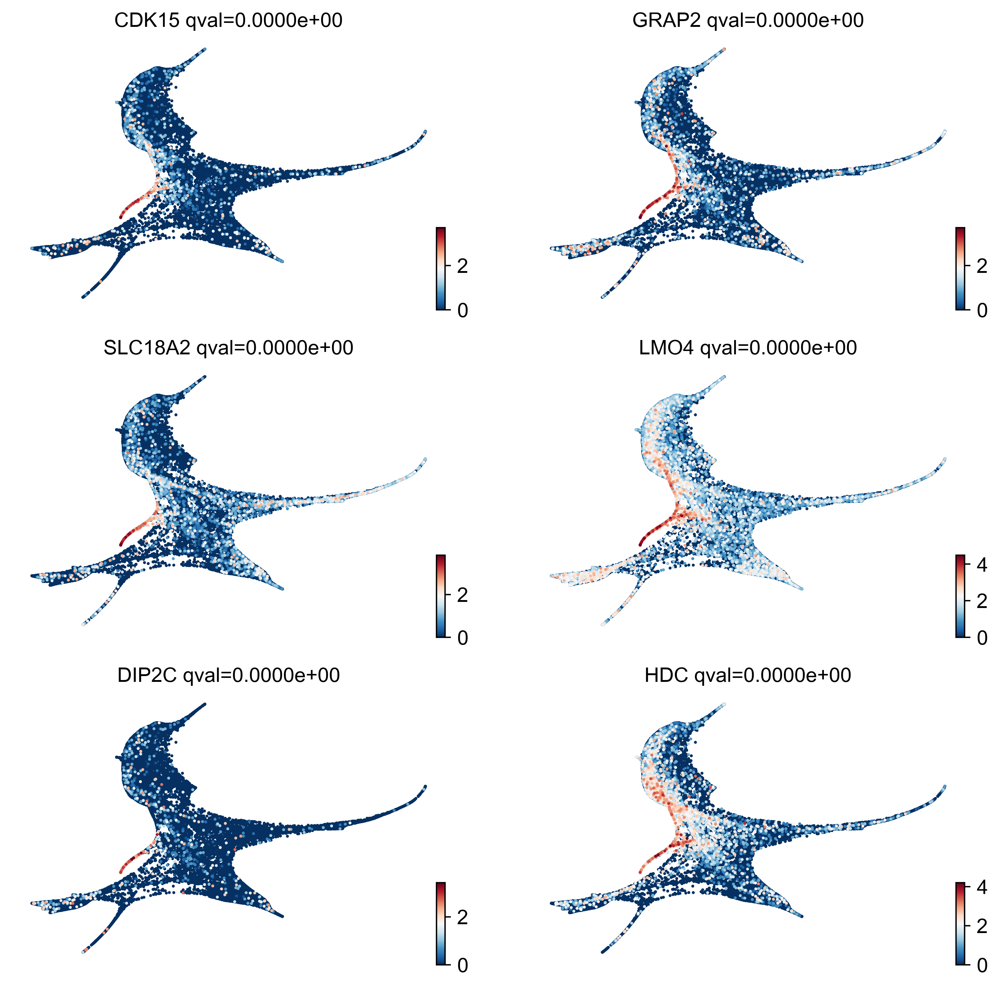

In [62]:
g_fwd.plot_lineage_drivers("Mast_cells", n_genes=6, basis='fle', ncols=2, figsize=(10,10), dpi=200)

In [63]:
pDCs_drivers = g_fwd.compute_lineage_drivers(lineages="pDCs", return_drivers=True)
pDCs_drivers.sort_values(by="pDCs_corr", ascending=False)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:03)


,pDCs_corr,pDCs_pval,pDCs_qval,pDCs_ci_low,pDCs_ci_high
featurekey,,,,,
NIBAN3,0.522144,0.0,0.0,0.513864,0.530326
PTPRS,0.463721,0.0,0.0,0.454792,0.472558
IRF8,0.460372,0.0,0.0,0.451407,0.469243
AFF3,0.440817,0.0,0.0,0.431654,0.449889
GRAMD1B,0.439512,0.0,0.0,0.430337,0.448597
...,...,...,...,...,...
PVT1,-0.324278,0.0,0.0,-0.334367,-0.314114
TFR2,-0.328139,0.0,0.0,-0.338199,-0.318004
GSE1,-0.345588,0.0,0.0,-0.355514,-0.335585


In [64]:
#save those into a file 
pfiltered = pDCs_drivers.copy()
pfiltered = pfiltered[pfiltered['pDCs_corr']>0]
pfiltered.to_csv('Single_Cell/Raw_Data/CELLRANK_outs/DRIVERS_pDCs.csv')

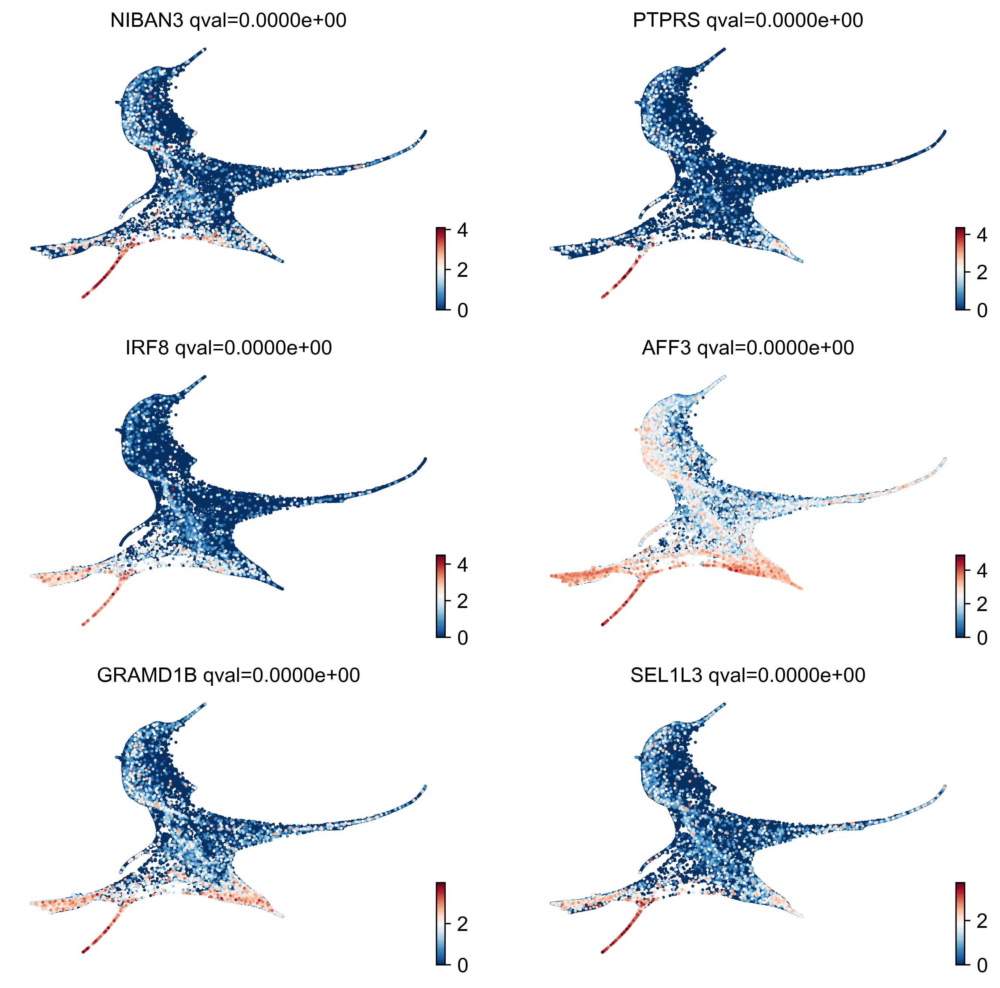

In [65]:
g_fwd.plot_lineage_drivers("pDCs", n_genes=6, basis='fle', ncols=2, figsize=(10,10), dpi=200)

In [66]:
Megakaryocytes_drivers = g_fwd.compute_lineage_drivers(lineages="Megakaryocytes", return_drivers=True)
Megakaryocytes_drivers.sort_values(by="Megakaryocytes_corr", ascending=False)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:04)


,Megakaryocytes_corr,Megakaryocytes_pval,Megakaryocytes_qval,Megakaryocytes_ci_low,Megakaryocytes_ci_high
featurekey,,,,,
DNM3,0.633972,0.0,0.0,0.627155,0.640692
ITGA2B,0.629664,0.0,0.0,0.622785,0.636445
ITGB3,0.621024,0.0,0.0,0.614023,0.627927
MED12L,0.602341,0.0,0.0,0.595082,0.609503
PBX1,0.564652,0.0,0.0,0.556895,0.572312
...,...,...,...,...,...
WNT5B,-0.252150,0.0,0.0,-0.262717,-0.241524
TFRC,-0.254494,0.0,0.0,-0.265046,-0.243880
FAM178B,-0.255293,0.0,0.0,-0.265841,-0.244684


In [67]:
#save those into a file 
pfiltered = Megakaryocytes_drivers.copy()
pfiltered = pfiltered[pfiltered['Megakaryocytes_corr']>0]
pfiltered.to_csv('Single_Cell/Raw_Data/CELLRANK_outs/DRIVERS_Megakaryocytes.csv')

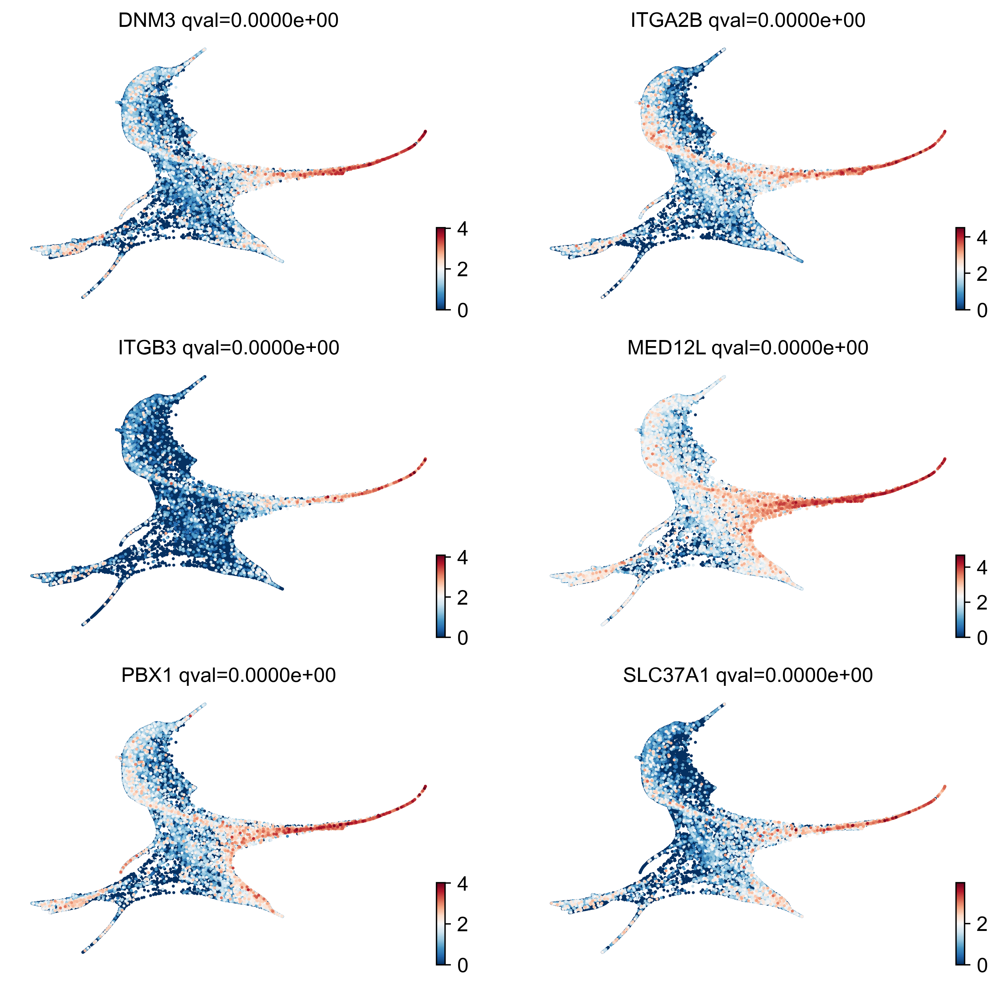

In [68]:
g_fwd.plot_lineage_drivers("Megakaryocytes", n_genes=6, basis='fle', ncols=2, figsize=(10,10), dpi=200)